In [11]:
import os
import tensorflow as tf
import random
import re
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import accuracy_score

from sklearn.metrics import confusion_matrix
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping,CSVLogger

import matplotlib.pyplot as plt
from keras_unet.models.custom_unet import conv2d_block, custom_unet
from sklearn.metrics import confusion_matrix
import itertools

In [21]:
##Helper functions for converting label codes to names

label_codes=[(255, 255, 255), (0, 0, 0)]
label_names=['building', 'background']

model_path='./saved_weights/model.h5'

id2code = {k:v for k,v in enumerate(label_codes)}
seed =42
bs =706
num_classes =2

def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs: 
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs: 
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3) 
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

In [22]:
# Normalizing only frame images, since masks contain label info
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

test_frames_datagen = ImageDataGenerator(**data_gen_args)
test_masks_datagen = ImageDataGenerator(**mask_gen_args)

DATA_PATH = './data/'



In [23]:
#Load the data
def TestAugmentGenerator(seed = seed, batch_size = bs):
    '''Test Image data generator
        Inputs: 
            seed - seed provided to the flow_from_directory function to ensure aligned data flow
            batch_size - number of images to import at a time
        Output: Decoded RGB image (height x width x 3) 
    '''
    test_image_generator = test_frames_datagen.flow_from_directory(
    DATA_PATH + 'test_frames/',
    batch_size = batch_size, seed = seed)


    test_mask_generator = test_masks_datagen.flow_from_directory(
    DATA_PATH + 'test_masks/',
    batch_size = batch_size, seed = seed)


    while True:
        X1i = test_image_generator.next()
        X2i = test_mask_generator.next()
        
        #One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]
        
        yield X1i[0], np.asarray(mask_encoded)
        
        

In [24]:
#load the model
model = custom_unet(
    (256,256,3),
    num_classes=num_classes,
    activation="relu",
    use_batch_norm=True,
    upsample_mode="deconv",  # 'deconv' or 'simple'
    dropout=0.3,
    dropout_change_per_layer=0.0,
    dropout_type="spatial",
    use_dropout_on_upsampling=True,
    use_attention=True,
    filters=16,
    num_layers=4,
    output_activation="sigmoid")
   

In [25]:
#compile the model
model.compile(optimizer='adam',loss='binary_crossentropy',
              metrics=['accuracy',tf.keras.metrics.MeanIoU(num_classes=num_classes)])

In [26]:
#load weights
model.load_weights(model_path)

#Make predictions
testing_gen = TestAugmentGenerator(batch_size=bs)
batch_img,batch_mask = next(testing_gen)
pred_all= model.predict(batch_img)

Found 1412 images belonging to 1 classes.
Found 1412 images belonging to 1 classes.


In [27]:
##flatten the prediction and groundtruth arrays for comparison
pred = pred_all.reshape((pred_all.shape[0]*pred_all.shape[1]*pred_all.shape[2]), pred_all.shape[3]).argmax(axis=1)
true = batch_mask.reshape((batch_mask.shape[0]*batch_mask.shape[1]*batch_mask.shape[2]), batch_mask.shape[3]).argmax(axis=1)

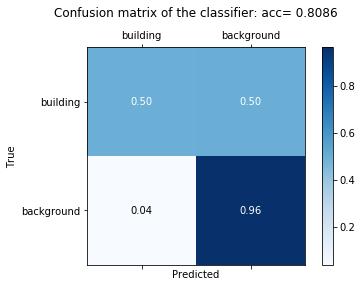

In [28]:
##Visualize the confusion matrix
labels = label_names
acc = round(accuracy_score(true,pred),4)
cm = confusion_matrix(y_true=true,y_pred=pred,labels=[0,1])

cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
cmap = plt.get_cmap('Blues')
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(cm,cmap=cmap)
plt.title(''.join(['Confusion matrix of the classifier: acc= ', str(acc)]), pad=20)

fig.colorbar(cax)
ax.set_xticklabels([''] + label_names)
ax.set_yticklabels([''] + label_names)
fmt = '.2f'
thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",verticalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.savefig('./visualizations/confusion_mat_v1.png')
plt.show()

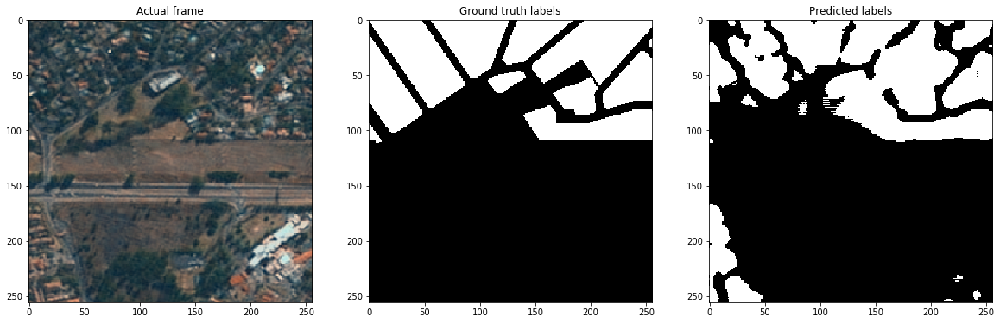

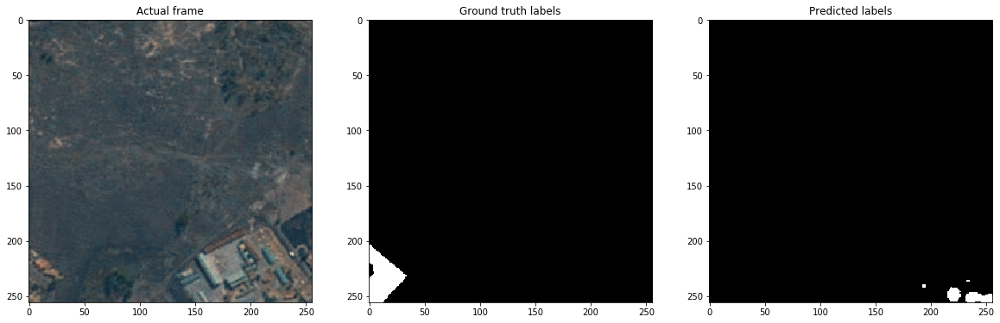

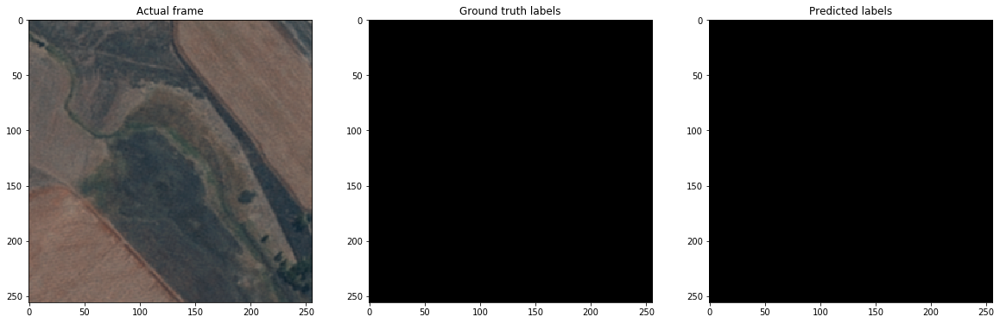

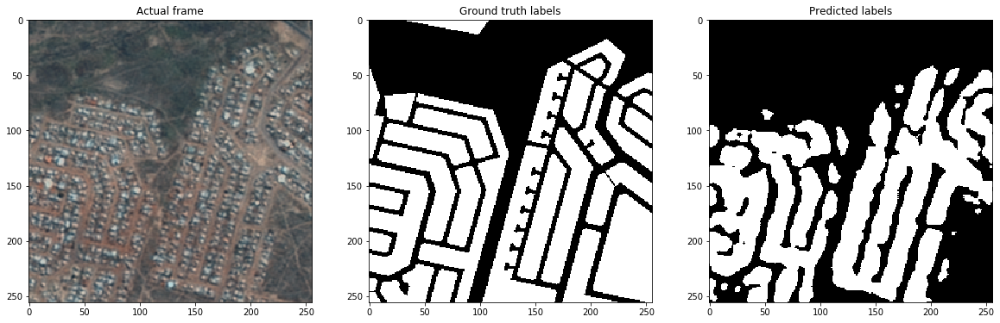

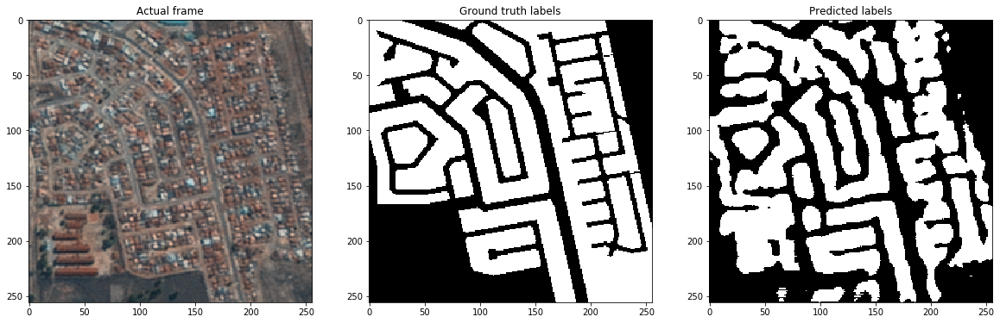

...

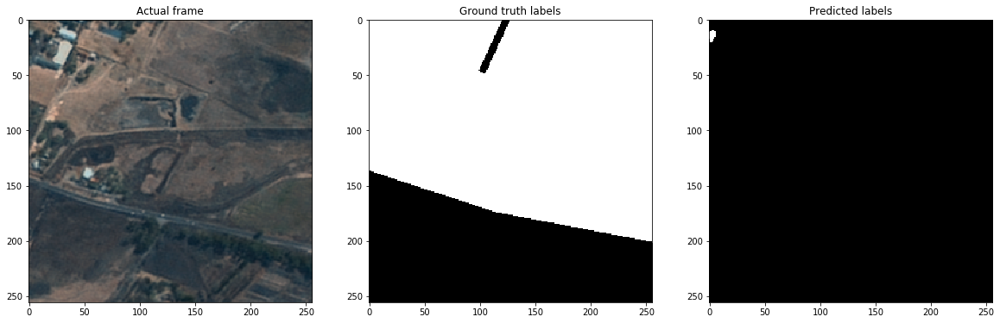

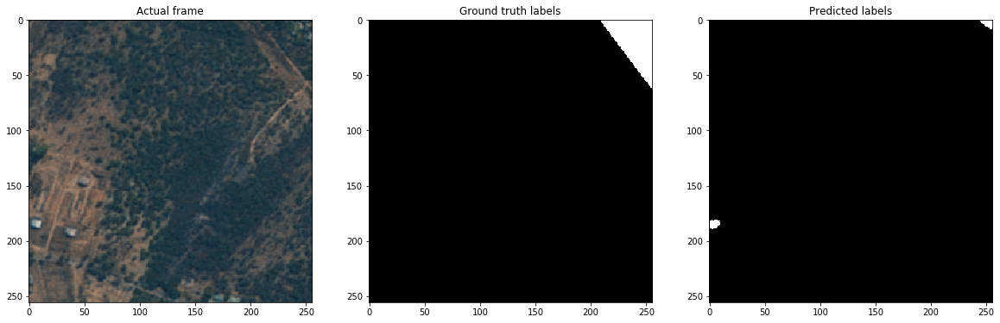

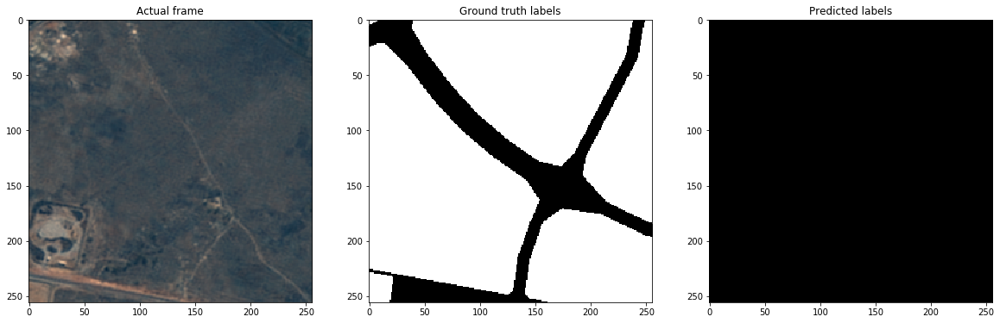

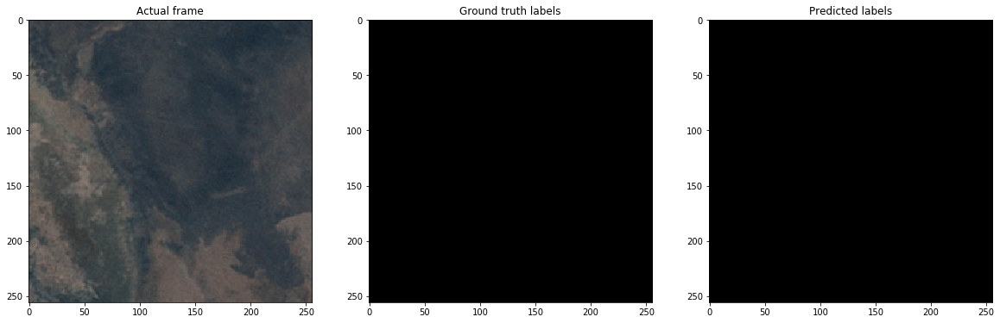

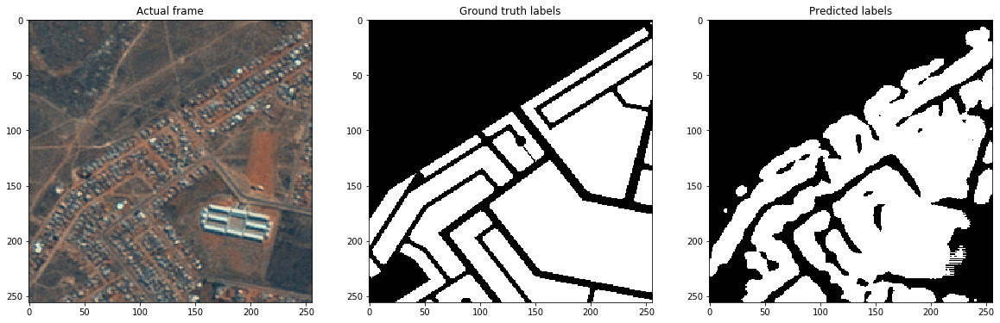

In [29]:
##Evaluate the predictions visually
rand=random.sample(range(1,500), 200 )
for i in rand:
    
    fig = plt.figure(figsize=(20,8))
    
    ax1 = fig.add_subplot(1,3,1)
    ax1.imshow(batch_img[i])
    ax1.title.set_text('Actual frame')
    ax1.grid(False)
    
    
    ax2 = fig.add_subplot(1,3,2)
    ax2.set_title('Ground truth labels')
    ax2.imshow(onehot_to_rgb(batch_mask[i],id2code))
    ax2.grid(False)
    
    ax3 = fig.add_subplot(1,3,3)
    ax3.set_title('Predicted labels')
    ax3.imshow(onehot_to_rgb(pred_all[i],id2code))
    ax3.grid(False)
    
    plt.show()